## Introducción

### Evolución población en España

In [1]:
import pandas as pd
from matplotlib import pyplot as plt
import geopandas as gpd

In [2]:
Poblacion = pd.read_excel('Poblacion_España.xlsx')

In [3]:
Poblacion.head()

,Periodo,Total Nacional
0,1 de enero de 1971,34040642
1,1 de enero de 1972,34408338
2,1 de enero de 1973,34800600
3,1 de enero de 1974,35177294
4,1 de enero de 1975,35569375


In [4]:
Poblacion['Año'] = Poblacion['Periodo'].str[-4:].astype('int')

Poblacion.head()

,Periodo,Total Nacional,Año
0,1 de enero de 1971,34040642,1971
1,1 de enero de 1972,34408338,1972
2,1 de enero de 1973,34800600,1973
3,1 de enero de 1974,35177294,1974
4,1 de enero de 1975,35569375,1975


In [5]:
Poblacion = Poblacion[(Poblacion['Año'] >1990) & (Poblacion['Año'] <=2021)]

Poblacion.head()

,Periodo,Total Nacional,Año
20,1 de enero de 1991,38881416,1991
21,1 de enero de 1992,39051336,1992
22,1 de enero de 1993,39264034,1993
23,1 de enero de 1994,39458489,1994
24,1 de enero de 1995,39639726,1995


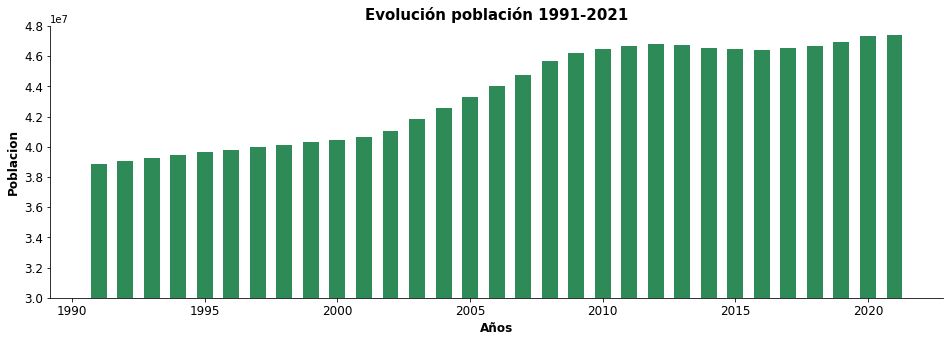

In [94]:
f, ax = plt.subplots(figsize=(16,5))

plt.bar(Poblacion['Año'], Poblacion['Total Nacional'], color = 'seagreen', width = 0.6)

ax.set_title("Evolución población 1991-2021", fontweight="bold", size=15)
ax.set_xlabel("Años", fontweight="bold", size=12)
ax.set_ylabel("Poblacion", fontweight="bold", size=12)
ax.set_ylim(3e7, 48e6)
ax.tick_params(labelsize=12)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)


plt.show()

Incremento población en estos 30 años

In [8]:
Incremento = ((Poblacion['Total Nacional'].loc[50] - Poblacion['Total Nacional'].loc[20])\
                /Poblacion['Total Nacional'].loc[20])*100

Incremento.round(2)

21.91

Evolución España zonas urbanas

In [111]:
ZonasUrbanas = pd.read_excel('Poblacion_Zonas_Urbanas.xls')

In [112]:
ZonasUrbanas.head(1)

,Country Name,Country Code,Indicator Name,Indicator Code,1960,1961,1962,1963,1964,1965,...,2012,2013,2014,2015,2016,2017,2018,2019,2020,2021
0,Aruba,ABW,Población urbana (% del total),SP.URB.TOTL.IN.ZS,50.776,50.761,50.746,50.73,50.715,50.7,...,42.957,42.99,43.041,43.108,43.192,43.293,43.411,43.546,43.697,43.866


In [113]:
ZonasUrbanasEspaña = ZonasUrbanas[ZonasUrbanas['Country Code'] == 'ESP']

In [114]:
ZonasUrbanasEspaña.drop(['Country Code', 'Indicator Name', 'Indicator Code'], axis = 1, inplace = True)

/home/dsc/anaconda3/lib/python3.8/site-packages/pandas/core/frame.py:4906: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [115]:
ZonasUrbanasEspaña = ZonasUrbanasEspaña.melt(id_vars='Country Name')

In [116]:
ZonasUrbanasEspaña.rename({'variable' : 'Año', 'value' : 'PorcentUrban'}, axis = 1, inplace = True)

In [117]:
ZonasUrbanasEspaña['Año'] = ZonasUrbanasEspaña['Año'].astype('int')

In [104]:
ZonasUrbanasEspaña = ZonasUrbanasEspaña[ZonasUrbanasEspaña['Año'] % 5 == 0] 

In [118]:
ZonasUrbanasEspaña

,Country Name,Año,PorcentUrban
0,España,1960,56.567
1,España,1961,57.303
2,España,1962,58.308
3,España,1963,59.306
4,España,1964,60.298
...,...,...,...
57,España,2017,80.080
58,España,2018,80.321
59,España,2019,80.565
60,España,2020,80.810


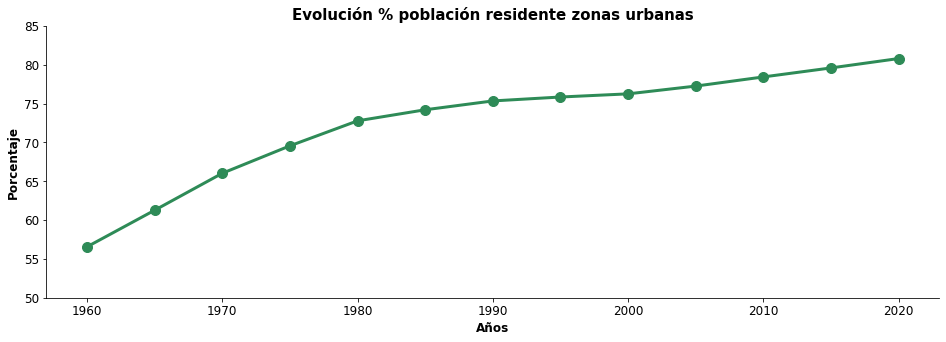

In [110]:
f, ax = plt.subplots(figsize=(16,5))

ax.plot(ZonasUrbanasEspaña['Año'], ZonasUrbanasEspaña['PorcentUrban'], color = 'seagreen',
        linewidth = 3, marker = 'o', markersize = 10)

ax.set_title("Evolución % población residente zonas urbanas", fontweight="bold", size=15)
ax.set_xlabel("Años", fontweight="bold", size=12)
ax.set_ylabel("Porcentaje", fontweight="bold", size=12)
ax.set_ylim(50, 85)
ax.tick_params(labelsize=12)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)


plt.show()

Zonas urbanas comparativa UE

In [81]:
path_Europa = 'GeoEU/CNTR_RG_01M_2020_4326.shp'
Mapa = gpd.read_file(path_Europa)
Mapa.head()

,CNTR_ID,CNTR_NAME,NAME_ENGL,NAME_FREN,ISO3_CODE,SVRG_UN,CAPT,EU_STAT,EFTA_STAT,CC_STAT,NAME_GERM,FID,geometry
0,PF,Polynésie Française,French Polynesia,Polynésie française,PYF,FR Territory,Papeete,F,F,F,Französisch-Polynesien,PF,"MULTIPOLYGON (((-134.46204 -23.36738, -134.476..."
1,KI,Kiribati,Kiribati,Kiribati,KIR,UN Member State,Tarawa,F,F,F,Kiribati,KI,"MULTIPOLYGON (((176.84759 -2.67149, 176.84559 ..."
2,AE,الإمارات العربية المتحدة,United Arab Emirates,Émirats arabes unis,ARE,UN Member State,Abu Dhabi,F,F,F,Vereinigten Arabischen Emirate,AE,"MULTIPOLYGON (((51.59056 24.24298, 51.59787 24..."
3,AD,Andorra,Andorra,Andorre,AND,UN Member State,Andorra la Vella,F,F,F,Andorra,AD,"POLYGON ((1.44257 42.60367, 1.45615 42.60265, ..."
4,AO,Angola,Angola,Angola,AGO,UN Member State,Luanda,F,F,F,Angola,AO,"MULTIPOLYGON (((23.42989 -17.63446, 22.85778 -..."


Nos quedamos solo con los paises que pertenecen a la UE

In [84]:
MapaUE = Mapa[Mapa['EU_STAT'] == 'T']

In [85]:
MapaUE.shape

(27, 13)

In [86]:
MapaUE.head()

,CNTR_ID,CNTR_NAME,NAME_ENGL,NAME_FREN,ISO3_CODE,SVRG_UN,CAPT,EU_STAT,EFTA_STAT,CC_STAT,NAME_GERM,FID,geometry
13,AT,Österreich,Austria,Autriche,AUT,UN Member State,Vienna,T,F,F,Österreich,AT,"MULTIPOLYGON (((10.45444 47.55580, 10.47320 47..."
18,BE,Belgien-Belgique-België,Belgium,Belgique,BEL,UN Member State,Brussels,T,F,F,Belgien,BE,"MULTIPOLYGON (((6.02100 50.75429, 6.03977 50.7..."
24,BG,България,Bulgaria,Bulgarie,BGR,UN Member State,Sofia,T,F,F,Bulgarien,BG,"POLYGON ((22.67516 44.21566, 22.69084 44.20456..."
51,DK,Danmark,Denmark,Danemark,DNK,UN Member State,Copenhagen,T,F,F,Dänemark,DK,"MULTIPOLYGON (((15.19308 55.32014, 15.19056 55..."
54,ES,España,Spain,Espagne,ESP,UN Member State,Madrid,T,F,F,Spanien,ES,"MULTIPOLYGON (((4.09361 40.06178, 4.10332 40.0..."


Cargamos tabla con el dato de zonas urbanas

In [76]:
ZonasUrbanas = pd.read_excel('Poblacion_Zonas_Urbanas.xls')

In [77]:
ZonasUrbanas.head()

,Country Name,Country Code,Indicator Name,Indicator Code,1960,1961,1962,1963,1964,1965,...,2012,2013,2014,2015,2016,2017,2018,2019,2020,2021
0,Aruba,ABW,Población urbana (% del total),SP.URB.TOTL.IN.ZS,50.776000,50.761000,50.746000,50.730000,50.715000,50.700000,...,42.957000,42.990000,43.041000,43.108000,43.192000,43.293000,43.411000,43.546000,43.697000,43.866000
1,NaN,AFE,Población urbana (% del total),SP.URB.TOTL.IN.ZS,14.563810,14.811410,15.069249,15.347976,15.640195,15.941282,...,33.040474,33.476208,33.936959,34.425581,34.894750,35.358898,35.847596,36.336258,36.828301,37.323697
2,Afganistán,AFG,Población urbana (% del total),SP.URB.TOTL.IN.ZS,8.401000,8.684000,8.976000,9.276000,9.586000,9.904000,...,24.160000,24.373000,24.587000,24.803000,25.020000,25.250000,25.495000,25.754000,26.026000,26.314000
3,NaN,AFW,Población urbana (% del total),SP.URB.TOTL.IN.ZS,14.705391,15.090123,15.484076,15.897592,16.329208,16.778650,...,42.925885,43.554094,44.180175,44.805863,45.425066,46.039478,46.649426,47.255413,47.857831,48.454806
4,Angola,AGO,Población urbana (% del total),SP.URB.TOTL.IN.ZS,10.435000,10.798000,11.204000,11.624000,12.058000,12.504000,...,61.268000,62.002000,62.731000,63.446000,64.149000,64.839000,65.514000,66.177000,66.825000,67.460000


In [78]:
ZonasUrbanas = ZonasUrbanas[['Country Code', '2021']]

ZonasUrbanas.rename({'Country Code' : 'ISO3_CODE'}, axis = 1, inplace = True)

In [79]:
ZonasUrbanas.head()

,ISO3_CODE,2021
0,ABW,43.866000
1,AFE,37.323697
2,AFG,26.314000
3,AFW,48.454806
4,AGO,67.460000


In [87]:
Urbanas = MapaUE.merge(ZonasUrbanas, on = 'ISO3_CODE')

In [126]:
Urbanas

,CNTR_ID,CNTR_NAME,NAME_ENGL,NAME_FREN,ISO3_CODE,SVRG_UN,CAPT,EU_STAT,EFTA_STAT,CC_STAT,NAME_GERM,FID,geometry,2021
0,AT,Österreich,Austria,Autriche,AUT,UN Member State,Vienna,T,F,F,Österreich,AT,"MULTIPOLYGON (((10.45444 47.55580, 10.47320 47...",58.995
1,BE,Belgien-Belgique-België,Belgium,Belgique,BEL,UN Member State,Brussels,T,F,F,Belgien,BE,"MULTIPOLYGON (((6.02100 50.75429, 6.03977 50.7...",98.117
2,BG,България,Bulgaria,Bulgarie,BGR,UN Member State,Sofia,T,F,F,Bulgarien,BG,"POLYGON ((22.67516 44.21566, 22.69084 44.20456...",76.025
3,DK,Danmark,Denmark,Danemark,DNK,UN Member State,Copenhagen,T,F,F,Dänemark,DK,"MULTIPOLYGON (((15.19308 55.32014, 15.19056 55...",88.240
4,ES,España,Spain,Espagne,ESP,UN Member State,Madrid,T,F,F,Spanien,ES,"MULTIPOLYGON (((4.09361 40.06178, 4.10332 40.0...",81.056
5,EE,Eesti,Estonia,Estonie,EST,UN Member State,Tallinn,T,F,F,Estland,EE,"MULTIPOLYGON (((28.04191 59.47012, 28.04319 59...",69.415
6,EL,Ελλάδα,Greece,Grèce,GRC,UN Member State,Athens,T,F,F,Griechenland,EL,"MULTIPOLYGON (((29.63524 36.11068, 29.63181 36...",80.038
7,CY,Κύπρος-Kıbrıs,Cyprus,Chypre,CYP,UN Member State,Nicosia,T,F,F,Zypern,CY,"MULTIPOLYGON (((34.60609 35.70767, 34.60060 35...",66.856
8,CZ,Česká Republika,Czechia,Tchéquie,CZE,UN Member State,Prague,T,F,F,Tschechien,CZ,"POLYGON ((14.82336 50.87055, 14.83161 50.87233...",74.214
9,DE,Deutschland,Germany,Allemagne,DEU,UN Member State,Berlin,T,F,F,Deutschland,DE,"MULTIPOLYGON (((10.45444 47.55580, 10.43954 47...",77.544


In [88]:
Urbanas = Urbanas.to_crs(epsg=4327)

In [89]:
lga_json = Urbanas.__geo_interface__

In [91]:
import plotly.express as px

In [92]:
tmp = Urbanas.copy()
zmin = Urbanas['2021'].min()
zmax = Urbanas['2021'].max()
fig = px.choropleth_mapbox(tmp, geojson=lga_json,locations=tmp.index,
                           color=tmp['2021'],
                           color_continuous_scale="viridis",
                           range_color=(zmin,zmax),
                           hover_name = Urbanas['NAME_ENGL'],   
                           mapbox_style="carto-positron",
                           zoom = 2.5 ,height = 500,
                           center = dict(lat = 50 , lon = 4),  
                           opacity=0.8,  
                           title = f"<b> % Población zonas urbanas UE</b>")
fig.update_layout(margin=dict(l=30, r=30, t=60, b=30))
fig.update_layout(font=dict(family='sans-serif',size=10))
fig.show()